In [1]:
#~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# LAB MODULE 2.
# Observational data in climate science
#~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

# Topics covered:
# (1) Organization of geospatial data in python
# (2) Operations in time
# (3) Operations in space 

# The purpose of this exercise is to (partially) replicate the process of 
# building of a global mean tempertaure anomaly curve from observations 

# Links: 
#   https://journals.ametsoc.org/doi/pdf/10.1175/1520-0450%281986%29025%3C0161%3ANHSATV%3E2.0.CO%3B2
#   https://www.metoffice.gov.uk/hadobs/crutem4/data/download.html  >>>  CRUTEM.4.6.0.0.station_files.zip



# CRUTEM (Climatic Research Unit TEMperature) is a gridded dataset of global historical near-surface air temperature anomalies over land at a monthly timescale. It is a collaborative product of the Climatic Research Unit at the University of East Anglia, the Met Office Hadley Centre and the National Centre for Atmospheric Science. CRUTEM also contributes the land air temperature station data to the global (land and ocean) temperature dataset called HadCRUT.

# CRUTEM5 is the fifth major version of the dataset, covering the time period from 1850, with a spatial resolution of 5° latitude by 5° longitude and a monthly-mean time resolution. The gridded temperature anomaly fields are based on a compilation of monthly-mean temperature observational records from weather stations. This compilation contains 10639 station records, but only 7983 records had the necessary coverage to be used for producing the gridded dataset. Anomalies are differences from average conditions in the 1961-1990 period. Hemispheric and global mean time series of land air temperature anomalies are also provided.

['"!!!!!!!!!" non Š riconosciuto come comando interno o esterno,',
 ' un programma eseguibile o un file batch.']

# Esempio: Passare da misure della tamperatura superficiale dell'aria (ottenute tramite varie stazioni meteorologiche nel mondo) a stimare quella che è l'andamento delle anomalie di temperatura media globale (che sono un indicatore del riscaldamento globale) di 50 anni circa

In [2]:
# Libraries

import os

# A bunch of other libraries that may be useful (you can use them or ignore them, or import different ones)

import numpy as np
import pandas as pd
import geopandas as gpd

import datetime as dtm
from datetime import datetime

import matplotlib.pyplot as plt
import cartopy.crs as ccrs

In [3]:
# Now let's have a look at one of them
# You can open the text files direclty with a text editor 
# Check as well the template with explanations: "crutem4_data_station_file_format.txt"

In [4]:
#-------------------------------------------------
#-- get info on database and files organization --
#-------------------------------------------------

# per capire come è costituito il nostro dataset
flist = [os.path.join(path, name) for path, subdirs, files in os.walk("./CRUTEM.4.6.0.0.station_files/") for name in files]  # contiene i dati grezzi derivanti da una serie di stazioni meteorologiche
for i in range(0,5):
  print (flist[i])

# exclude first 2 items, not relevant
flist=flist[2:]

# Alternativly
#import glob
#flist = glob.glob("./CRUTEM.4.6.0.0.station_files/"+'/*/*')

print ('\n',flist[0:5])
nst=len(flist)
print ("\n > Number of stations = ",nst)  # abbiamo più di 10k stazioni

./CRUTEM.4.6.0.0.station_files/Index
./CRUTEM.4.6.0.0.station_files/34\346070
./CRUTEM.4.6.0.0.station_files/34\341230
./CRUTEM.4.6.0.0.station_files/34\348240
./CRUTEM.4.6.0.0.station_files/34\347400

 ['./CRUTEM.4.6.0.0.station_files/34\\341230', './CRUTEM.4.6.0.0.station_files/34\\348240', './CRUTEM.4.6.0.0.station_files/34\\347400', './CRUTEM.4.6.0.0.station_files/34\\341860', './CRUTEM.4.6.0.0.station_files/34\\345611']

 > Number of stations =  10295


In [5]:
# Task 1 
# We need to import the data in python and organize them for further analyses and operations, both in time and space.

# STRUTTURA DEI FILE

# Try to start thinking of a suitable way to organize this dataset, consisting of ~10,000 stations, each one having:
# - a unique identifier
# - string metadata (e.g. name, country)
# - numerical metadata (e.g. latitude, longitude, elevation) >> lat & lon are also the spatial dimensions we'll need
# - other metadata
# - a time series at monthly resolution oragnized as 2D tabs (year, month)

# Consider the data structures you know of, keeping in mind the final purpose that will require somehow 
# aggregating this dataset in time and space. 

# Bear in mind that this is real raw data that could have incomplete/erroneous file coding etc.
# Other than that, we will assume that all the reported data are correct and directly usable, 
#   considering the reality that time series have missing data and different time span.

In [6]:
# We will consider the actual time & space operation in the next stages.

In [7]:
# We are back !
# Here are a few initial considerations.

# First, let's start from the consideration that time series have missing data and different time span.
# In order to oraganize temporal data coherently, we need a common time axis, on which to place correctly our obs.
# >> datetime objects provide this kind of functionality

# The time series are currently organized as inpependent 2D tabs; 
# it will be necessary to expand them into 1D time series

# In this way we could associate a 1D time series to each station;
# a pandas dataframe (which can host datetime objects) coust host this kind of data ...

# ... however, we also have metadata to consider. Above all, we need lat & lon to place our station in space.
# In addition, we have staion names, countries and elevation which may be of interest.
# Additional metadata could be useful (or not?) for later data processing.

# What about geopandas? 
# That could at least store lat/lon coordinates as a point geometry.
# True. However, other metadata do not find a place in this configuration.

# Could we place all metadata for a station at the same level of all the tempearture values?
# We could, at the price of losing the datetime functionalities ... does not seemm worth

# Is there any n-D structure that could host our data?
# numpy arrays indeed can be up to 7D, but they do not seem to be what we need here.

# MORALE: it is challenging to find a unique data structure to accommodate conveniently the whole dataset.

In [8]:
# Possible strategies >>

#    -----> (A) Store temperature time series per each station in pandas df
#           (rows=stations & columns=months; or the other way round ?)
#           and all the metadata in a separate df. A unique identifier will allow relating the 2 dataframes at any time.

# (B) Same as above, except using geopandas gdf to also include lat/lon along with data, rather than with metadata.
#     This option may be useful if we ever needed gdp functions for space operations. 
#     BUT: I can only place geometry in a column, which means they will be associated to a row representing a station.
#     What about datetime objects? Could they stay in columns as well ? 
#     Or they need to be asscoated to the df index (so to be the 1st column themselves) to be used as we need ?

# (C) Define a new class of objects including the structures defined above.
#     This would "free" us from having to keep track of two differnt dataframes, with more compact and efficient code,
#     but it likely implies more effort to define the class and procedures.

# (D) Other ideas ?

In [9]:
# For this example I will start by simply acquiring data & metadata in separate dataframes

In [10]:
# METADATI


# The first challenge is to correctly read in the data from an individual ASCII files.

# Define df to store ##metadata##.
# Station IDs will be used as unique identifiers for both dataframes.

metadata0 = pd.DataFrame(columns=['ID','stname','country','elev','lat','lon'])
metadata0

,ID,stname,country,elev,lat,lon


In [11]:
# DATI


# costruiamo un asse temporale comune (granularità mensile)

# First, I will define a common time axis, along which all time series will be aligned. This will be the index of gdf.

taxis = pd.date_range('1850-01', '2019-01', freq='M')
nmonths=len(taxis)
nyears=nmonths/12

# Define df to store data (temperature time series) and location. 

data0 = pd.DataFrame({'time': taxis})
data0 = data0.set_index(['time'])
data0

""
time
1850-01-31
1850-02-28
1850-03-31
1850-04-30
1850-05-31
...
2018-08-31
2018-09-30
2018-10-31


In [12]:
# PERIODO DI RIFERIMENTO

# Define reference period

# a noi ci interessano le anomalie di temperatura rispetto ad un periodo di riferimento
yref0 = 1961
yref1 = 1990

In [13]:
  # ribadiamo la struttura

  # FROM THE TEMPLATE ...

  # Number= 037760  
  # Name= LONDON/GATWICK
  # Country= UK
  # Lat=   51.2
  # Long=    0.2
  # Height= 59
  # ...
  # Obs:
  # 1961   3.9   7.1   7.5  10.3  11.0  14.7  15.9  16.1  15.7  10.9   6.4   2.7   501   501   501   501   501   501   501   501   501   501   501   501 
  # 1962   4.1   4.5   2.5   7.6   9.8  13.0  15.1  14.7  12.6  10.5   5.9   1.7   501   501   501   501   501   501   501   501   501   501   501   501 
  # ...

In [14]:
# Dataset acquisition

nst_tmp = nst   # numero delle stazioni
# nst_tmp = 200   #nst #200

#- set counters for diagnostics 
nodatacount=0  
tooshortcount=0 
outsidecount=0

from tqdm import tqdm

# itero su tutti i file
for si in tqdm(range(0,nst_tmp)):

  #- open file 
  
  filein=flist[si]  # elenco di tutti i percorsi dei file, di tutte le nostre stazioni
  
  #- Scan text file to find starting line of data matrix &
  #- check for the actual presence of data

  # apro ogni file relativo ad una stazione
  try:
      with open(filein) as f: data = f.readlines()
      skipi = data.index("Obs:\n")+1  # divide la prima parte che contiene i metadati e la seconda parte che contiene i dati
      if (len(data)-skipi < 2):
        nodatacount+=1  # se non abbiamo dati vado a incrementare il contatore nodatacount
        continue

      #- Find out how many years are in the time series for this station &
      #-   apply some filters on the time series lenght and/or timing as a condition to include the station in the dataset
      #- I could use the metadata (Start year, End year) or
      #-   get this piece of info from the actual data >>> I chose the second option

      # applico dunque già dei filtri

      #- I read the first column of the data table, which constains the list of years
      yr = np.genfromtxt(filein, skip_header=skipi, delimiter=None, usecols=0, dtype='i4')
      nyr = len(yr)

      # this filters out data series that are too short (e.g. less than 30 years)
      if (nyr < 30):
        tooshortcount+=1
        continue

      # do not retain series not covering at least in part the reference period
      #if (yr[0]>yref1 or yr[-1]<yref0):
      #  outsidecount+=1
      #  continue

      # OR

      # retain only the stations for which the calculation of the average annual cycle for the reference period
      # yields non-NAN values for each month, i.e. the normals have no missing value

      norm_line = [line for line in data if "Normals=" in line]
      norm = str(norm_line).split("=",1)[1]
      norm  = norm[:-4].strip()
      if (norm.find("-99.0") > -1):   #str.find returns the position of the given substring, -1 if not found, controllo se ci sono missing values
        outsidecount+=1
        continue

      #- If the station is retained, then gather data & metadata
          # se la stazione non è stata scartata possiamo iniziare ad estrarre i metadati

      # FROM THE TEMPLATE ...
      # Name= LONDON/GATWICK
      # Country= UK
      # Lat=   51.2
      # Long=    0.2
      # Height= 59

      # Get local values for * METADATA * of interest

      # considerando tutti gli elementi dei metadati
      stname_line = [line for line in data if "Name=" in line]
      stname = str(stname_line).split("=",1)[1]
      stname  = stname[:-4].strip()

      country_line = [line for line in data if "Country=" in line]
      country = str(country_line).split("=",1)[1]
      country  = country[:-4].strip()  # this removes leading & trailing strings, incl. "new line" [\n] at the end

      elev_line = [line for line in data if "Height=" in line]
      elev = str(elev_line).split("=",1)[1]
      elev = float(elev[:-4].strip())

      lat_line = [line for line in data if "Lat=" in line]
      lat = str(lat_line).split("=",1)[1]
      lat = float(lat[:-4].strip())

      lon_line = [line for line in data if "Long=" in line]
      lon = str(lon_line).split("=",1)[1]
      lon = float(lon[:-4].strip())

      # Append local values to metadata df
      # creo questa struttura
      metadata0 = metadata0.append({
         "ID": filein[-6:],
         "stname": stname,
         "country": country,
         "elev": elev,
         "lat":  lat,
         "lon":  lon,
         }, ignore_index=True)

        # ora passiamo ad acquisire i dati veri e propri

      #- Finally, read and arrange * DATA * (temperature time series)

      # FROM THE TEMPLATE ...
      # ...
      # Obs:
      # 1961   3.9   7.1   7.5  10.3  11.0  14.7  15.9  16.1  15.7  10.9   6.4   2.7   501   501   501   501   501   501   501   501   501   501   501   501
      # 1962   4.1   4.5   2.5   7.6   9.8  13.0  15.1  14.7  12.6  10.5   5.9   1.7   501   501   501   501   501   501   501   501   501   501   501   501

      # We need to go from 2D to 1D oragnization of temperature data &
      #  associate each temperature to a datetime index
      # This way we can coherently build a 2D df (time, station),
      #  on which we could later drop stations or slice/gropuby by time
      # >>> I will build a local df, then append it to the general df

      #- build local time axis
      # yr: the first column of the data table, which constains the list of years (defined above)

      ti0 = datetime.strptime(str(yr[0]), "%Y")
      ti1 = datetime.strptime(str(yr[nyr-1]+1), "%Y")
      stime = pd.date_range(ti0, ti1, freq='M')
      if ((yr[nyr-1]-yr[0]+1) != len(yr)):  # check if data of any year are missing within the first and last year
        print('WARNING: station {} has missing years !'.format(metadata0.ID[si]))

      #- read in the 2D table (left side with temperature data) as a numpy array, which I can later reshape into 1D

      loc_data_2d = np.genfromtxt(filein, skip_header=skipi, filling_values='-99.0', delimiter=None, dtype='float')[:,1:13]  #[rows,cols]
      loc_data_1d = loc_data_2d.flatten()

      #- check that the order of element rearrangement is correct
      #print(np.shape(loc_data_2d),nyr)
      #print('@@',loc_data_2d[:2,:])
      #print(loc_data_1d[:24],'\n')

      #- build local station dataframe, using the station ID as column name

      xdf = pd.DataFrame({'time': stime, filein[-6:]: np.asarray(loc_data_1d)})
      xdf = xdf.set_index('time')

      #- merge into global dataframe, using the station ID as column name

      data0 = pd.merge(data0, xdf, on='time', how='left')
  except:
      print(f)
      continue

  0%|          | 0/10295 [00:00<?, ?it/s]C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
  0%|          | 1/10295 [00:00<1:08:26,  2.51it/s]C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
  0%|          | 3/10295 [00:00<26:19,  6.52it/s]  C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in

<_io.TextIOWrapper name='./CRUTEM.4.6.0.0.station_files/96\\961690' mode='r' encoding='cp1252'>


C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
 60%|█████▉    | 6148/10295 [06:32<03:01, 22.82it/s]C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
C:\Users\loren\AppData\Local\Temp\ipykernel_20448\1447787101.py:99: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metadata0 = metadata0.append({
 60%|█████▉ 

è stato necessario inserire un try & except dal momento in cui il file 961690 non presentava la sezione dei dati, quindi il codice "Obs:\n" genereva un errore

In [15]:
data0

,341230,348240,347400,341860,345611,346010,343560,346460,343980,345610,...,614420,614210,617660,619900,612500,610990,618110,614990,618340,617210
time,,,,,,,,,,,,,,,,,,,,,
1850-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-16.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-6.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31,21.4,NaN,25.2,21.7,NaN,NaN,NaN,NaN,-99.0,NaN,...,26.8,NaN,26.4,22.9,NaN,-99.0,NaN,NaN,NaN,NaN
2018-09-30,17.6,NaN,20.0,17.3,NaN,NaN,NaN,NaN,-99.0,NaN,...,29.5,NaN,26.8,23.4,NaN,27.8,NaN,NaN,NaN,NaN
2018-10-31,9.4,NaN,13.0,8.5,NaN,NaN,NaN,NaN,-99.0,NaN,...,28.6,NaN,28.5,23.8,NaN,27.8,NaN,NaN,NaN,NaN


In [16]:
metadata0

,ID,stname,country,elev,lat,lon
0,341230,VORONEZ-------------,RUSSIA,149.0,51.7,-39.2
1,348240,PRIMORSKO-AHTARSK,RUSSIA,3.0,46.0,-38.2
2,347400,GIGANT--------------,RUSSIA,64.0,46.5,-41.3
3,341860,ERSOV---------------,RUSSIA,111.0,51.3,-48.3
4,345611,VOLSHSKIY GMO,RUSSIAN FEDER,28.0,48.7,-44.5
...,...,...,...,...,...,...
7452,610990,GAYA,NIGER,202.0,11.9,-3.5
7453,618110,SIGUIRI,GUINEA,362.0,11.4,9.1
7454,614990,AIOUN EL ATROUSS,MAURITANIA,223.0,16.7,9.6
7455,618340,KISSIDOUGOU,GUINEA,524.0,9.1,10.1


In [17]:
# Print some info

print(nodatacount,' stations with no data (not acquired)')
print(tooshortcount,' stations with too little data (not acquired)')
print(outsidecount,' stations with not enough data for the ref. period (not acquired)')
print("{} [{}] valid stations acquired".format(nst_tmp-nodatacount-tooshortcount-outsidecount,len(metadata0.ID)))

13  stations with no data (not acquired)
2049  stations with too little data (not acquired)
775  stations with not enough data for the ref. period (not acquired)
7458 [7457] valid stations acquired


In [18]:
print(metadata0)  # metadati di tutte le stazioni

          ID                stname        country   elev   lat   lon
0     341230  VORONEZ-------------         RUSSIA  149.0  51.7 -39.2
1     348240     PRIMORSKO-AHTARSK         RUSSIA    3.0  46.0 -38.2
2     347400  GIGANT--------------         RUSSIA   64.0  46.5 -41.3
3     341860  ERSOV---------------         RUSSIA  111.0  51.3 -48.3
4     345611         VOLSHSKIY GMO  RUSSIAN FEDER   28.0  48.7 -44.5
...      ...                   ...            ...    ...   ...   ...
7452  610990                  GAYA          NIGER  202.0  11.9  -3.5
7453  618110               SIGUIRI         GUINEA  362.0  11.4   9.1
7454  614990      AIOUN EL ATROUSS     MAURITANIA  223.0  16.7   9.6
7455  618340           KISSIDOUGOU         GUINEA  524.0   9.1  10.1
7456  617210   GEORGETOWN_GM34GRGT    GAMBIA, THE    1.0  13.5  14.8

[7457 rows x 6 columns]


In [19]:
print(data0.iloc[1500:1505,0:10])  # solo alcuni mesi

            341230  348240  347400  341860  345611  346010  343560  346460  \
time                                                                         
1975-01-31    -3.8     0.3    -1.4    -7.0    -3.9   -99.0    -4.2    -2.1   
1975-02-28    -7.8    -1.3    -3.4   -11.8    -6.7   -99.0    -7.8    -4.9   
1975-03-31     0.0     4.6     1.8    -1.6     1.0   -99.0     0.6     1.0   
1975-04-30    13.1    14.4    14.9    13.7    14.4   -99.0    14.5    13.6   
1975-05-31    19.1    19.7    19.5    19.0    20.6   -99.0    20.0    19.7   

            343980  345610  
time                        
1975-01-31    -5.3    -3.9  
1975-02-28   -11.1    -6.7  
1975-03-31    -1.3     1.0  
1975-04-30    13.3    14.4  
1975-05-31    19.8    20.6  


In [20]:
# Now think of additional pre-processing operations / checks that might be desirable

# abbiamo acquisito i dati ma dobbiamo fare ancora del pre processing

In [21]:
# Convert all missing values (-99.0) into NAN
data0[data0 == -99.0] = np.nan

In [22]:
# Take station IDs as index for metadata0
metadata0 = metadata0.set_index(['ID'])

In [23]:
# Fix longitudes, dato che le longitudini sono state invertite
metadata0.lon = -metadata0.lon

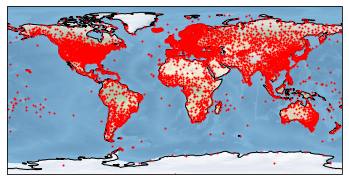

In [24]:
# Plot stations in our dataset, utilizzando latitudine e longitudine contenuti del df dei metadati

ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.stock_img()
ax.scatter([metadata0.lon],[metadata0.lat],color='r',marker='o',s=1.0)
plt.show()

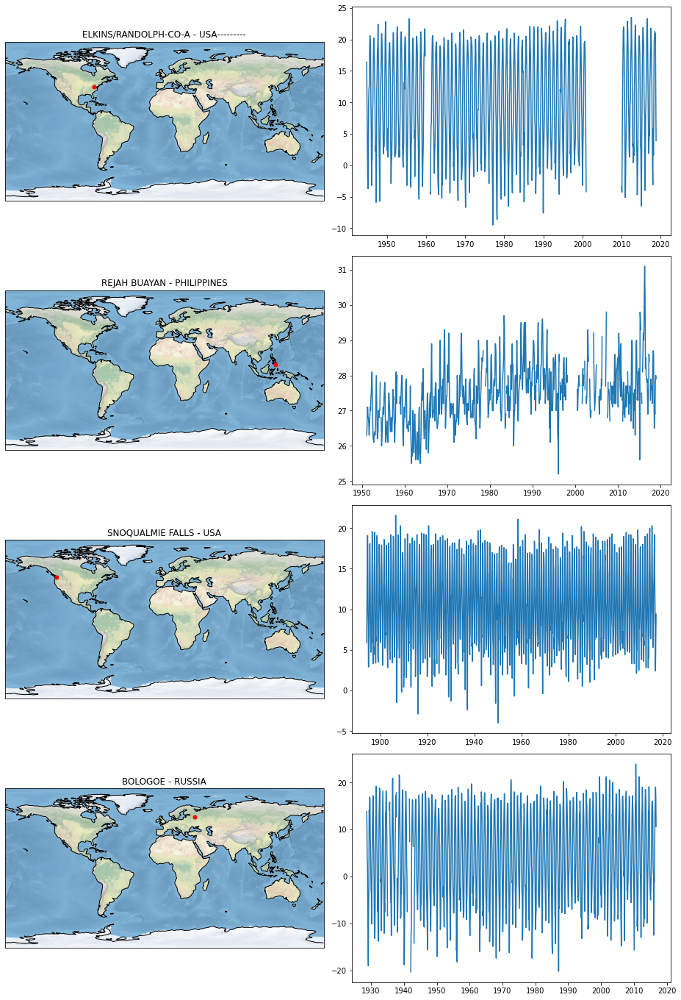

In [25]:
#-- Plot time series from a few randomly chosen stations --

# oltre alle stazioni come informazioni abbiamo anche le serie temporali che sono associate alle varie stazioni

#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 4  # number of randomn stations to pick, c'era 6

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())         
 
    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()  
    plt.plot(data0[ssite[fi]])

fig.tight_layout()
plt.show()


# vediamo posizioni differenti, serie temporali con coperture differenti

In [ ]:
# ora possiamo iniziare a lavorare


# Then let's start exploting our datasets towards the final goal

# (1) Deal with the time series, in particular what do about missing data (nothing or anything else?)

# (2) Transform all TEMPERATURE time series to TEMPERATURE ANOMALY time series, with respect to a reference period, trasformare serie di temperatura in serie di anomalie di temperatura, ci interessa sottrarre alloa nostra serie le normali climatiche, ovvero il ciclo annuale medio, ovvero la media

# poi servono step di aggregazione, nello spazio e nel tempo:

# (3) First step of spatial aggregation: gridding at monthly time step - se ho più stazioni in una cella faccio la media

# (4) Aggregate the gridded data from monthly to annual time step

# (5) Second step of spatial aggregation: derive the global time series from the gridded dataset

In [ ]:
# PASSO 1


# (1) Deal with the time series, in particular what to do about missing data

# We could decide 
#   to retain only stations with complete records, 
#   or to retain for every station only the years with at least 6 months of data, etc.
# We could also decide e.g.
#   to assign the missing data based on the nearest (in time) value for the same month at the same station
#   or to assign the missing data based on the nearest (in space) value for the same month from a different station

# In this example I will just go on without further pre-processing operations

In [ ]:
# PASSO 2

# (2) Transform all TEMPERATURE time series to TEMPERATURE ANOMALY time series, with respect to a reference period
# vengono calcolate delle climate normals (AVERAGE ...) rispetto al periodo di riferimento su base mensile. Effettuando la differenza (DATI - AVERAGE) è possibile rimuovere il ciclo annuale dai dati e centrare i dati stessi.

# ANOMALY(y,m) = DATA(y,m) - AVERAGE[ref. period](m) , for each month (m=1..12), for each year (y=1850..2019)

# AVERAGE[ref. period](m) is in fact the "Normals", that we could have stored while acquiring the data & metadata, or
#  alternatively we could recalculate here. I will show how to proceed for the second option.

In [26]:
# calcoliamo le CLIMATE NORMALS

# First, let's identify the position along the time index that corresponds to the begining/end of the reference period

# sono i due indici, inziale e finale, del periodo di riferimento
x1=data0.index.get_loc('1961-01-31')
x2=data0.index.get_loc('1990-12-31')

# Then calculate the "Normals"

data_normals = data0[x1:x2].groupby(data0[x1:x2].index.month).mean()  # vengono cosi calcolate le normali climatiche, ovvero le medie su base mensile, ho le climate normals stazione per stazione per i 12 mesi dell'anno. Per ogni stazione ho cosi il ciclo annuale medio rispetto al periodo di riferimento


# abbiamo 12 righe dove la prima è gennaio e il valore rispettivo per una data stazione è la media di tutti i valori di temperatura a gennaio di tutti gli anni (quindi temperatura gennaio 1961 + temp gennaio 1962 ecc diviso N stazioni e si ottiene cosi la meia per gennaio e cosi via dicendo per gli altri mesi). Quindi io so che in media (dato che ho preso un orizzonte abbastanza ampio di 30 anni) la temperatura in una stazione in un certo mese in media è quella, mi posso apsettare quel valore.
data_normals

,341230,348240,347400,341860,345611,346010,343560,346460,343980,345610,...,614420,614210,617660,619900,612500,610990,618110,614990,618340,617210
time,,,,,,,,,,,,,,,,,,,,,
1,-8.816667,-2.190000,-4.600000,-11.860000,-7.953571,-4.93,-8.866667,-5.860000,-11.116667,-7.946667,...,21.124138,20.348148,25.367857,25.996667,23.076667,25.721053,25.084615,22.071429,22.590000,25.357143
2,-8.080000,-1.190000,-3.726667,-11.443333,-7.875000,-2.77,-8.396667,-5.333333,-11.230000,-7.483333,...,22.738462,22.433333,26.544828,26.093333,25.810000,28.911111,27.707692,25.711111,24.961111,27.513043
3,-2.310000,3.403333,1.706667,-4.906667,-1.355172,1.38,-2.256667,0.083333,-3.840000,-1.313333,...,24.131034,25.351852,27.203448,25.776667,29.456667,31.847368,30.008000,28.259259,27.011111,29.621739
4,7.703333,11.320000,10.856667,7.316667,9.643333,9.86,8.773333,9.523333,8.883333,9.643333,...,24.337037,27.342857,27.367857,24.810000,33.130000,33.636842,30.976923,31.503571,26.757895,31.030435
5,14.876667,17.246667,16.750000,15.700000,16.913333,16.42,16.096667,16.426667,16.943333,16.900000,...,25.381481,30.546429,27.803704,23.173333,35.323333,31.758824,29.532000,34.803704,25.616667,31.450000
6,18.133333,21.586667,20.686667,19.513333,21.123333,20.48,19.913333,20.716667,21.633333,21.113333,...,26.792857,33.918519,27.404167,21.740000,34.656667,29.242105,26.900000,34.569231,24.500000,30.304762
7,19.563333,23.973333,23.506667,21.773333,23.543333,22.72,21.933333,23.246667,24.086667,23.526667,...,26.903704,34.607407,26.565217,21.043333,32.153333,27.152632,25.388462,32.160000,23.805556,27.965217
8,18.390000,23.080000,22.686667,19.960000,22.013333,21.47,20.543333,22.160000,21.853333,22.010000,...,28.138462,34.250000,26.340000,20.768966,30.630000,26.426316,25.107692,30.444000,23.805263,27.366667
9,12.860000,18.090000,17.096667,13.883333,16.100000,16.54,14.493333,16.736667,15.431034,16.086667,...,29.244444,32.766667,26.544000,21.290000,31.830000,26.965000,25.481481,30.630769,24.125000,27.372727


In [27]:
# ora calcoliamo le ANOMALIE, quindi sottraiamo mese per mese alla nostra serie temporale il valore del corrispettivo mese delle climate normals


# Finally, let's subtract normals from the the original time series, to get
# the time series of the temperature anomalies for each station 
# (Note that this operation would be efficiently done with 2D data organization, such as in the original text files)

# Make a copy of data0 (data_anom) to store the anomalies

data_anom = data0.copy()  # è necessario .copy() altrimenti data0 viene sovrascritto

# Then loop through all the years (January) in the time axis, and substract the Normals from each chunk of 12 months

# differenza tra serie storiche singole delle varie stazioni e normali appena calcolate. La differenza che otteniamo sono le anomalie di temperature, ovvero quella stazione registra una temperatura che è differente da quella media, da quelle che ci aspetteremmo.

y0=0
for yi in range(0,int(nyears)):
  data_anom.iloc[y0:y0+12,:] = data0.iloc[y0:y0+12,:]-np.array(data_normals.iloc[:,:])
  y0+=12

data_anom

,341230,348240,347400,341860,345611,346010,343560,346460,343980,345610,...,614420,614210,617660,619900,612500,610990,618110,614990,618340,617210
time,,,,,,,,,,,,,,,,,,,,,
1850-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-8.653333,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.583333,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.286667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-5.643333,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.700000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31,3.010000,NaN,2.513333,1.740000,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.338462,NaN,0.060000,2.131034,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-30,4.740000,NaN,2.903333,3.416667,NaN,NaN,NaN,NaN,NaN,NaN,...,0.255556,NaN,0.256000,2.110000,NaN,0.835000,NaN,NaN,NaN,NaN
2018-10-31,3.396667,NaN,3.536667,3.363333,NaN,NaN,NaN,NaN,NaN,NaN,...,0.073077,NaN,1.130769,1.403333,NaN,-1.031579,NaN,NaN,NaN,NaN


In [ ]:
# osservando i dati sopra riportati (le tabelle data0, data_norm e data_anom) si può verificare che le anomalie sono state correttamente calcolate.

# esempio: si considera il valore di data0 (la nostra serie) 1976-05-31 pari a -1.9, si considera il valore di maggio nelle climate normals (il valore che in media ci aspetteremmo) pari a -3.687500. La anomalia, ovvero di quanto si discosta la nostra serie dalla normale, sarà pari a -1.9 - (- 3.687500) che risulta come indicato pari a 1.787500.

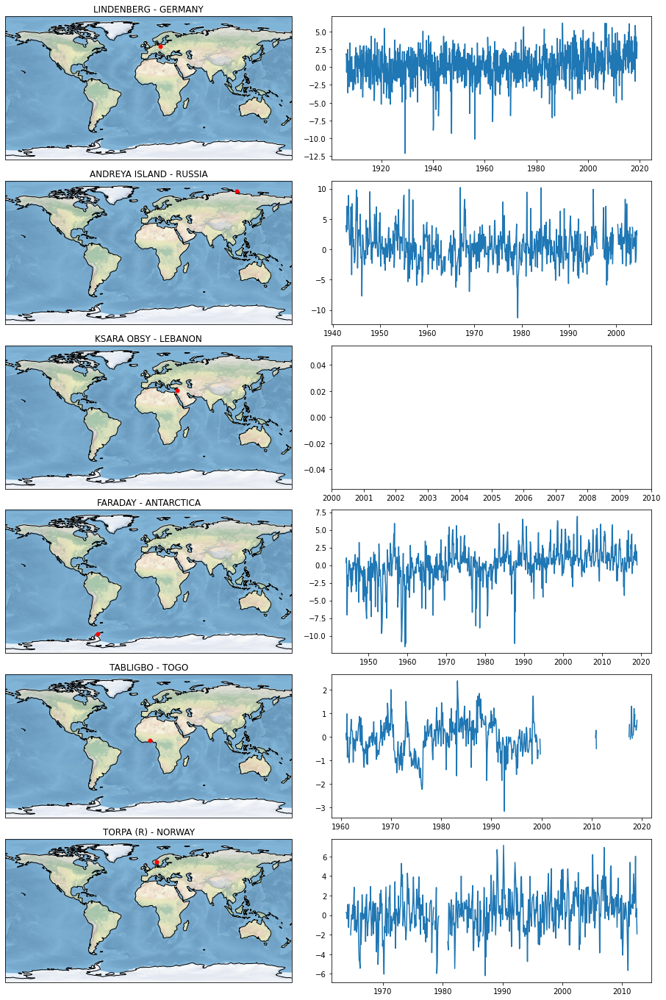

In [28]:
#-- Plot time series from a few randomly chosen stations --
# plotto come prima ma in questo caso le anomalie calcolate, effettivamente i dati sono centrati intorno allo zero in un periodo di riferimento. Guardando i grafici sarebbe necessario gestire i missing values. Queste serie non mostrano neanche chiari segni di cicli annuali (vedi infatti formula, abbiamo sottratto anche il ciclo annuale).

#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 6   # number of randomn stations to pick

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())         
 
    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()  
    plt.plot(data_anom[ssite[fi]])

fig.tight_layout()
plt.show()

In [ ]:
# PASSO 3


# il primo step di aggregazione spaziale lo possiamo effettuare a base mensile (cioè facciamo un'aggregazione spaziale, uniremo più stazioni in un'unica cella, considerando per ora dati mensili).
# poi faremo lo step di aggregazione temporale (convertiremo i dati mensili in dati a granularità annuale)
# e poi step finale di aggregazione (globale, (con i 2 emisferi) e poi globale tutta la terra)

# (3) First step of spatial aggregation: gridding at monthly time step - si crea una griglia regolare, omogeneizziamo la distribuzione spaziale del nostro dataset facendo la media delle anomalie delle stazioni presenti nelle celle insieme



# è un'operazione manuale: assegno alle celle definite da lat e long (che ciclo tutte) le stazioni la cui lat e long rientrano in esse. Quindi avrò alla cella lat x e long y assegnate dellle stazioni. Poi lo step successivo, verso la fine, sarà una grande aggregazione spaziale, globale, che verrà fatta con la media, sarà la media di queste celle.


# All data are aggregated (averaged) in a regular lat/lon grid covering the Earth surface (e.g. 10x10 or 5x5 deg.)
# In this way, we are "homogenizing" the spatial distribution of our dataset

# Here there are a few strategies that can be followed. 

# One way would be to build a grid (e.g. a couple of 1D lists/arrays or one 2D array) containing the 
#  lats/lons margins of grid cells. Then slicing based on lats and lons ranges can be used to calculate the average
#  time series from the grid cell.

# A similar approach (non è l'approccio seguito) could be devised using geopandas, attributing lat/lon station coordinates to point geometries,
#  defining the regular grid as a series of polygons. Then it would be possible to use geopandas geometry functions
#  to operate a "geometry slicing", i.e. points contained within a given polygon.
#  http://blog.yhat.com/posts/interactive-geospatial-analysis.html

In [ ]:
# PASSO 4 e 5


# (4) Aggregate the gridded data from monthly to annual time step

# By doing this operation after (3), we are in fact still exploiting data from stations with some missing data

In [ ]:
# In this phase we can either
# - consider all data, irrespective of the fact that a given year has NAN for ceratin values
# - or set to NAN all incomplete years

In [ ]:
# I will proceed in this example, using the first strategy, for both (3) and (4)

In [29]:
# create grid 

resol = 20 #5  # degrees (E and N)
nlon = int(360/resol)  # sono le ricghe verticali
nlat = int(180/resol)  # sono le ricghe orizzontali

# define grid cell margins

grlons = np.empty([nlon+1],dtype='float')  # sono i margini verticali, sono le righe grigie della griglia
grlats = np.empty([nlat+1],dtype='float')  # sono i margini orizzontali, sono le righe grigie della griglia
grlons[0] = -180.
grlats[0] = -90.
for i in range(1,nlon+1):
  grlons[i]=grlons[i-1]+resol
for i in range(1,nlat+1):
  grlats[i]=grlats[i-1]+resol

In [30]:
# Create data structure to host the gridded dataset:
# what will it be ?  -> I chose 3D numpy array

# queste strutture riempite temporaneamente con dei nan
# sono array tridimensionali, numero matrici, numero righe, numero colonne
# nmonths,nlat,nlon sono le dimensioni
data_mo = np.empty([nmonths,nlat,nlon],dtype=float)
data_mo[:,:,:] = np.nan

data_yr = np.empty([int(nyears),nlat,nlon],dtype=float)
data_yr[:,:,:] = np.nan

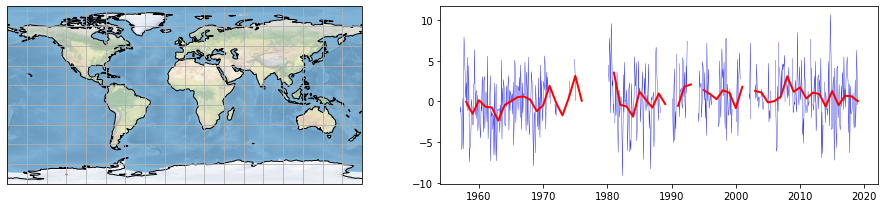

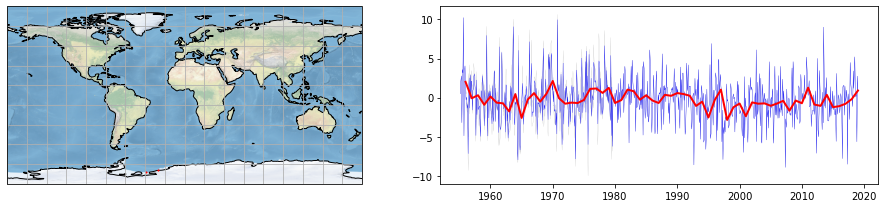

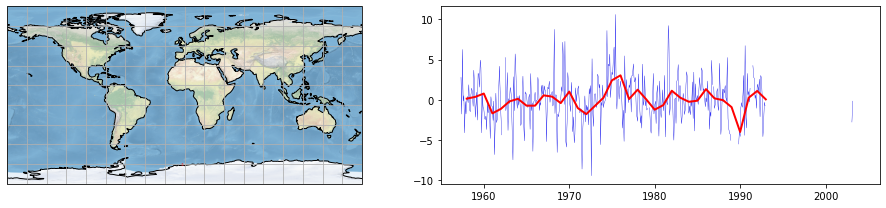

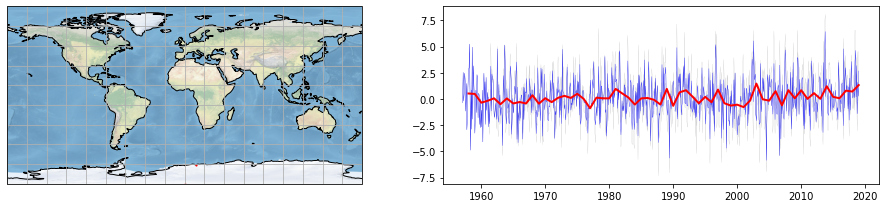

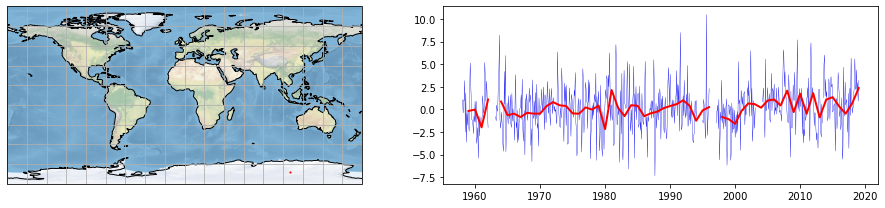

...

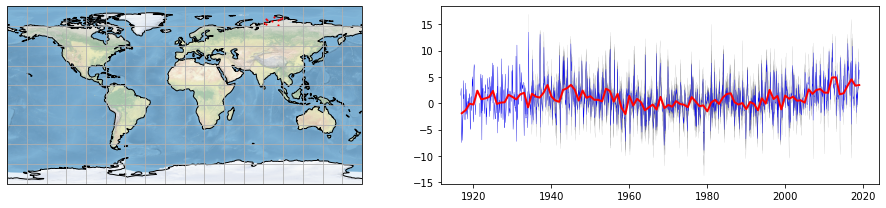

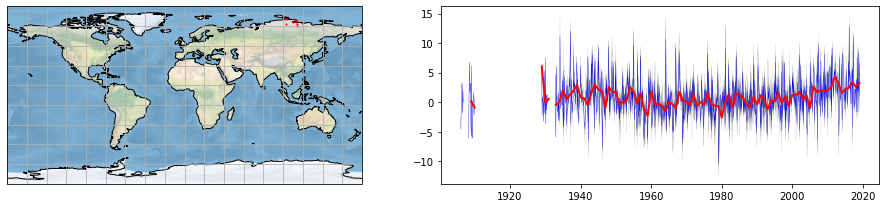

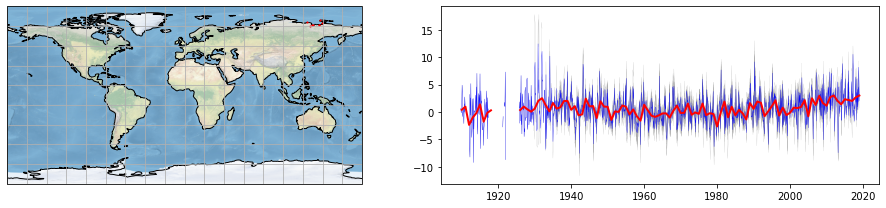

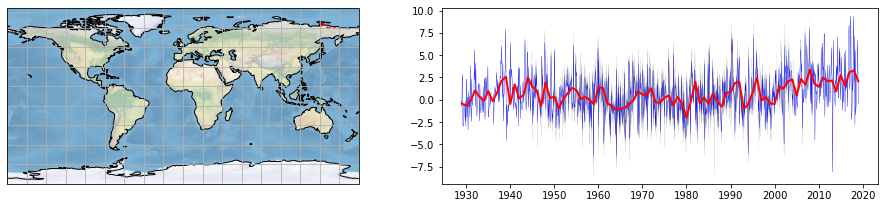

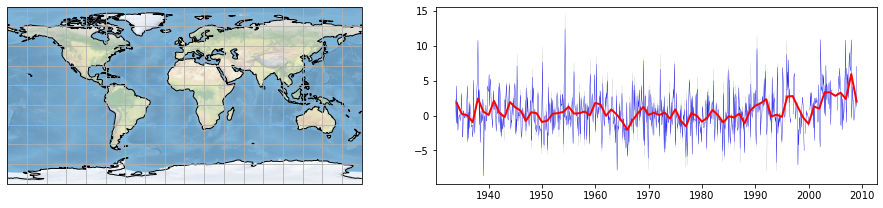

In [33]:
# Iterate over grid cells and 
# - get the average time series of all stations in grid cell at monthy resolution
# - integrate to annual resolutin  

# ciclo sulle latitudini e longitudini
# vado ad analizzare ogni cella della griglia che ho creato singolarmente
for j in range(0,nlat):
  for i in range(0,nlon):

    # faccio in pratica un subsetting di tutte le coordinate delle singole stazioni

    # ad esempio mi trovo nella prima cella, 0:0
    dummy = metadata0[metadata0.lon >= grlons[i]]  # vado a selezionare tutte le stazioni (sono gli id in metadata0) che rientrano nella cella 0 ad esempio, <, >= ecc sono i vincoli per far si che la stazione sia dentro quella cella
    dummy = dummy[dummy.lon < grlons[i+1]]
    dummy = dummy[dummy.lat >= grlats[j]]
    dummy = dummy[dummy.lat < grlats[j+1]]

    #print('*',grlons[i],grlons[i+1],grlats[j],grlats[j+1])
    #print(dummy.index)

    if (len(dummy.index) > 0):  # se c'è almeno una stazione in quella cella
 
      # calculation - vado a calcolare la media di tutte le stazioni che sono nell'elenco della cella

      data_mo[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1)).flatten()  # media su base mensile, colore blu, ci saranno tante stazioni in una cella, ogni stazione avrà la sua curva di anomalie, si fa una media di tutte queste curve, quindi in questo caso tutto su base mensile?
        
      data_yr[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1).resample("Y").mean()).flatten()  #  media su base annuale, colore rosso

      # in grigio sono le anomalie delle stazioni prese separatamente, non calcolando dunque la media
      # display to check things  

      fig = plt.figure(figsize=(13,3))  
      subplots = (1,2)
      n_panels = subplots[0] * subplots[1]

      #- locate on map
      ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
      ax.stock_img()
      ax.coastlines()
      ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))
      ax.scatter([dummy.lon],[dummy.lat],color='r',marker='o',s=1.2)  # i dummy ci sono tutte le stazioni all'interno della cella considerata
         
      #- time series
      tser = fig.add_subplot(subplots[0], subplots[1], 2)
      plt.plot(taxis,np.array(data_anom[dummy.index]),color='grey',linewidth=0.1)
      plt.plot(taxis,data_mo[:,j,i],color='blue',linewidth=0.3)
      plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='red',linewidth=2)  

      fig.tight_layout()  
      plt.show()
      # alcuni outliers potrebbero essere eliminati

In [ ]:
# PASSO 5

# (5) Second step of spatial aggregation: derive the global time series from the gridded dataset
# devo fare un'aggregazione di tutte le celle  -  in questo viene fatta una semplice media aritmetica, sarebbe incorretta, infatti sarebbe opportuno utilizzare una media pesata
# per fare la media pesata avremmo dovuto qualche passo prima calcolare i pesi con la funzione cos considerando le latitudini

# il primo step di aggregazione spaziale è stato necessario perchè non partivo come in altri esempi che abbiamo visto con file netcdf, quindi nel primo step ho dovuto io creare manualmente una griglia e in base alle lat e long delle stazioni assegnare ciascuna stazione alla griglia in cui ricadeva. Una volta fatto ciò è stata fatta la media cosa che ho fatto anche negli esempi successivi, ciò che è stato diverso dunque è stato il primo passo che non è necessario negli esempi successivi avendo già tutto ben strutturato nei file nccdf.

In [ ]:
# Here we have the options of a simple arithmetic average, or a weighted average
# The weights could be on several levels, e.g.
# - a measure of the density of observations or their coherence
# - the unequal areas covered by each grid cell
# - the unequal proportions of land vs ocean in different grid cells
# - ...

In [ ]:
# In this case, I will simply use the arithmetic average

In [1]:
# Prepare to display to check things  

fig = plt.figure(figsize=(13,13))  
subplots = (2,1)

ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
ax.stock_img()
ax.coastlines()
ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))

tser = fig.add_subplot(subplots[0], subplots[1], 2)

# Initialize data structure to host global average temperature anomaly time series

data_glob = np.empty([int(nyears)],dtype=float)
data_glob[:] = np.nan

# loop over all grid cells

for j in range(0,nlat):
  for i in range(0,nlon):
    
    # Check if current grid cell has an associated time series
    
    if not(np.isnan(data_yr[:,j,i]).all()):
     
      #  place a marker on the map, and plot individual grid cell time series 

      ax.plot( grlons[i:i+2].sum()/2, grlats[j:j+2].sum()/2,
         color='red', marker='x', markersize=5,transform=ccrs.PlateCarree())     
      plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='gray',linewidth=0.1) 

# calculate the global average at each time step      
        
for t in range(0,int(nyears)):  

    local = data_yr[t,:,:]
    valid = np.isnan(data_yr[t,:,:])  # prima si prendevano tutti gli anni, considerando una determinata cella e quindi una determinata lat/long(linea rossa grafici sopra), ora si considera l'anno e si fa la media di tutte le celle, quindi si considera un anno specifico e tutte le lat/lot relative e viene fatta la media
    data_glob[t] = np.nanmean(local[~valid])  # qui si poteva fare una media pesata, per l'anno X si fa la media in questo caso semplicemente aritmetica di tutte le celle

# plot the global average curve  
    
plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_glob[:],color='red',linewidth=2) 

fig.tight_layout()  
plt.show()

# # la linea rossa è la global mean temperature anomalies (gmta), ovvero la media di tutte le anomalie di tutte le stazioni, quindi a livello globale, con granularità annuale

NameError: name 'plt' is not defined

In [35]:
# print to file the time series of global mean temperature anomalies

# stampo su file quest'ultima serie temporale (linea rossa)

gmta = pd.DataFrame({'time': pd.date_range('1850-01', '2019-01', freq='Y')})
gmta['gmta'] = data_glob[:]
gmta = gmta.set_index(['time'])

gmta.to_csv('_'.join(['gmta',str(int(nst_tmp)),'stations']))

In [ ]:
# Note that estimation of uncertainties in the different passages could be calculated, and propagated
# Also, it would be possible to perform several realizations of selecting sub-gropus of stations (bootstrap)
# Several "cleaning" / pre-processing operations could be considered, e.g. removal of outliers (e.g. > n St.dev.)

In [36]:
gmta

,gmta
time,
1850-12-31,-0.564252
1851-12-31,-0.117734
1852-12-31,-0.329241
1853-12-31,-0.369994
1854-12-31,-0.060377
...,...
2014-12-31,0.963406
2015-12-31,1.020377
2016-12-31,1.453652


In [ ]:
# riassumendo, rispetto agli esempi successivi, qui non ho file netcdf ma ho dei dataset con dentro lat long ecc.

# quindi mi creo una griglia manualmente avendo cosi un reticolo di celle lat/long assegno guardando il dataframe le varie stazioni in base alle loro coordinate alle varie celle., una stazione avrà dei valori di temperatura per ciascun istante temporale
# in questo modo è stato fatto il primo step di aggregazione spaziale, ogni cella ha al suo interno tutte le stazioni e per ogni cella si calcolerà un valore meddio (mensile e annuale)

# il secondo step serve per avere una visione generale, si fa una media globale, come se fosse un'unica grande cella. Nei plot finali prima ho una sequenza in cui ogni riga di plot ha un set di lat/long fissate e si prendono tutti gli anni. Nell'ultimo plot generale invece si cicla su anno fissa e qls lat/long in modo da calcolare per ogni anno. La media che viene fatta in questo caso è semplicemente aritmetia

# con i file netcdf non serve il primo step di aggregazione spaziale e comunque in ogni caso si tratta di file e strutture dati abbastanza diverse quindi ha anche poco senso fare dei confronti, anche perchè in questo primo caso stiamo affrontando delle serie storiche